Dupla:
- Matheus Vargas - 119039821
- Thalles Nonato - 119058809

In [3]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import colorcet as cc

In [13]:
sns.set_theme()

In [4]:
df = pd.read_csv("data.csv")

In [4]:
df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
df.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653.000000,1.706530e+05,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000
mean,0.528587,1976.787241,0.502115,0.537396,2.309483e+05,0.482389,0.084575,0.167010,5.199844,0.205839,-11.467990,0.706902,31.431794,0.098393,116.861590
std,0.263171,25.917853,0.376032,0.176138,1.261184e+05,0.267646,0.278249,0.313475,3.515094,0.174805,5.697943,0.455184,21.826615,0.162740,30.708533
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.615000,0.000000,11.000000,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.580000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624000e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


In [7]:
df = df.drop(["id", "artists", "name", "release_date"], axis=1)

Padronizando os dados:

In [8]:
scaler = StandardScaler()
atributos = ["valence", "acousticness", "danceability", "duration_ms", "energy", "explicit", "instrumentalness", "key", "liveness", "loudness", "mode", "popularity", "speechiness", "tempo", "year"]
df[atributos] = scaler.fit_transform(df[atributos])
df[atributos].mean()

valence            -7.461296e-17
acousticness       -2.105151e-16
danceability       -7.381354e-16
duration_ms         5.862447e-17
energy             -3.810591e-16
explicit           -3.197698e-17
instrumentalness   -5.329497e-17
key                 9.626404e-17
liveness           -2.228396e-16
loudness            1.305727e-16
mode                7.328059e-18
popularity         -4.530073e-17
speechiness         0.000000e+00
tempo              -8.060865e-17
year                1.327045e-15
dtype: float64

In [9]:
n_categorias = df.shape[1]

In [10]:
# Fazendo o SVD
U, S, V = np.linalg.svd(df[atributos], full_matrices=False)

In [11]:
np.linalg.norm((U @ np.diag(S) @ V) - df[atributos])

1.2660940023704156e-11

Pela norma de Frobenius, podemos ver que as matrizes são praticamente iguais.

Vendo a relevância de cada componente principal:

In [12]:
S/S.sum() * 100

array([14.55743151,  9.78084991,  8.67564131,  7.88858224,  7.68426398,
        7.05076741,  6.97287289,  6.68145132,  6.31395513,  5.75698987,
        5.21463621,  4.23921995,  4.01130967,  2.64993984,  2.52208876])

In [5]:
def matriz_rank_r(SVD, r):
    U, S, V = SVD
    matriz = np.zeros(V.shape)
    
    for i in range(r):
        matriz += np.outer(U.T[i], S[i] * V[i])
    
    return matriz

In [6]:
def erro_por_posto(matriz, SVD):
    U, S, V = SVD
    
    x, y = [], []
    for i in range(len(S)):
        x.append(i+1)
        y.append(np.linalg.norm(matriz - matriz_rank_r(SVD, i+1)))
    
    sns.scatterplot(x=x, y=y)
    plt.ylabel("Erro")
    plt.xlabel("Posto da matriz aproximada")
    plt.show()

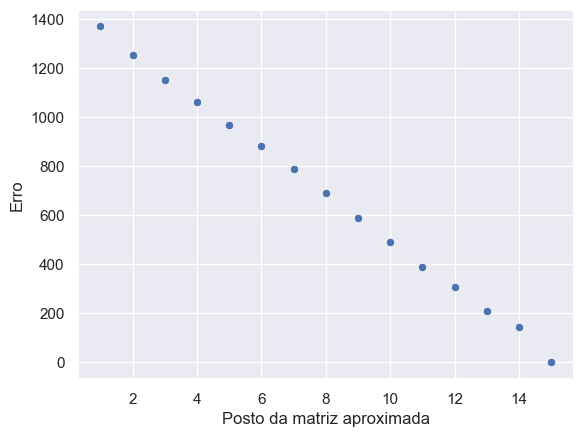

In [15]:
erro_por_posto(df[atributos], (U, S, V))

Não há nenhum "cotovelo". Aparentemente todos os componentes da matriz têm relevância.

Agora plotando as categorias em dimensão 1:

(0.95, 2.0)

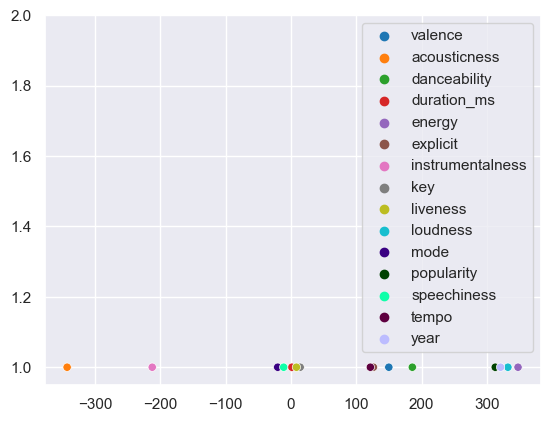

In [16]:
sns.scatterplot(x=V[0]*S[0], y=[1]*n_categorias, hue=atributos, palette=sns.color_palette(cc.glasbey_category10, n_categorias))
plt.ylim([0.95,2])

E em dimensão 2:

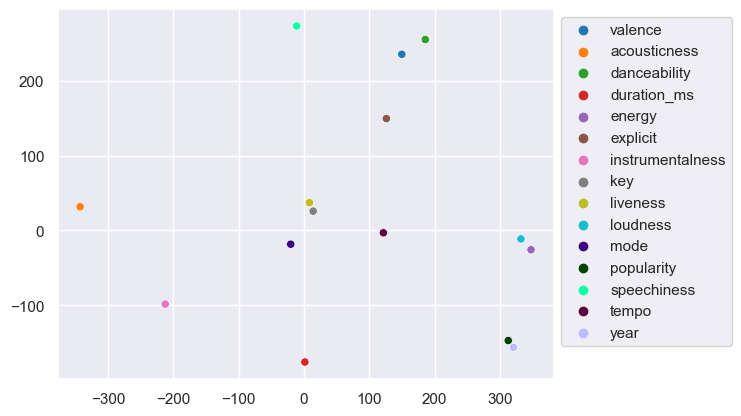

In [17]:
ax = sns.scatterplot(x=V[0]*S[0], y=V[1]*S[1], hue=atributos, palette=sns.color_palette(cc.glasbey_category10,n_categorias))
sns.move_legend(ax,'upper left', bbox_to_anchor=(1,1))

Clusterizando:

In [18]:
kmeans = KMeans(n_clusters=6, n_init="auto")
kmeans.fit(X=list(zip(V[0]*S[0], V[1]*S[1])))
kmeans.labels_

array([2, 4, 2, 3, 0, 2, 5, 3, 3, 0, 3, 0, 1, 3, 0])

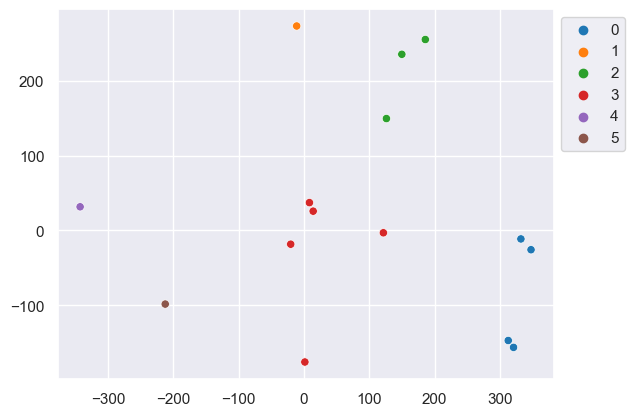

In [19]:
ax = sns.scatterplot(x = V[0] * S[0] , y = V[1] * S[1], hue = kmeans.labels_, palette='tab10')
sns.move_legend(ax,'upper left', bbox_to_anchor=(1,1))

Identificando os clusters:

In [20]:
clusters = [[] for i in range(6)]
for atributo, cluster in zip(atributos, kmeans.labels_):
    clusters[cluster].append(atributo)
clusters

[['energy', 'loudness', 'popularity', 'year'],
 ['speechiness'],
 ['valence', 'danceability', 'explicit'],
 ['duration_ms', 'key', 'liveness', 'mode', 'tempo'],
 ['acousticness'],
 ['instrumentalness']]

Agora clusterizando com todas as dimensões.

Tentando encontrar o número ideal de clusters:

In [58]:
def inercia_por_n(matriz, maximo):
    x, y = [], []
    for i in range(1, maximo+1):
        kmeans = KMeans(n_clusters=i, n_init="auto", random_state=0)
        kmeans.fit(matriz)
        x.append(i)
        y.append(kmeans.inertia_)
    
    sns.scatterplot(x=x, y=y)
    plt.ylabel("Distâncias intra-cluster")
    plt.xlabel("Número de clusters")
    plt.show()

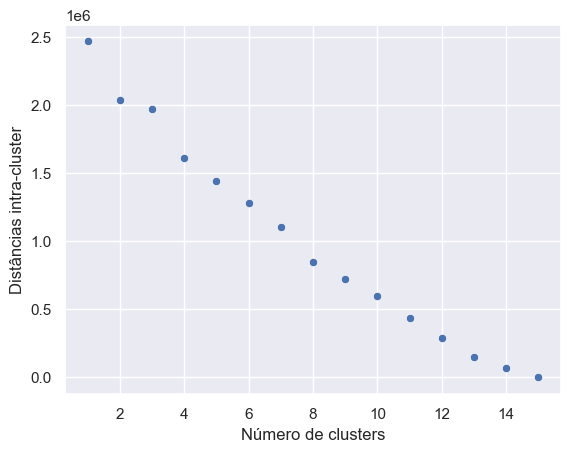

In [22]:
inercia_por_n(V @ np.diag(S), n_categorias)

Novamente sem "cotovelos".

In [23]:
n = 8
kmeans = KMeans(n_clusters=n, n_init="auto", random_state=0)
kmeans.fit(V @ np.diag(S))
kmeans.labels_

clusters = [[] for i in range(n)]
for atributo, cluster in zip(atributos, kmeans.labels_):
    clusters[cluster].append(atributo)
clusters

[['speechiness'],
 ['liveness'],
 ['valence', 'acousticness'],
 ['popularity'],
 ['duration_ms', 'energy', 'instrumentalness', 'mode', 'tempo', 'year'],
 ['danceability'],
 ['explicit', 'key'],
 ['loudness']]

---
---

In [36]:
df.columns

Index(['valence', 'year', 'acousticness', 'artists', 'danceability',
       'duration_ms', 'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date',
       'speechiness', 'tempo'],
      dtype='object')

In [7]:
df = df.drop(["artists", "id", "release_date"], axis="columns").set_index("name")

In [8]:
scaler = StandardScaler()
df[:] = scaler.fit_transform(df)

In [9]:
df.mean()

valence            -7.461296e-17
year                1.327045e-15
acousticness       -2.105151e-16
danceability       -7.381354e-16
duration_ms         5.862447e-17
energy             -3.810591e-16
explicit           -3.197698e-17
instrumentalness   -5.329497e-17
key                 9.626404e-17
liveness           -2.228396e-16
loudness            1.305727e-16
mode                7.328059e-18
popularity         -4.530073e-17
speechiness         0.000000e+00
tempo              -8.060865e-17
dtype: float64

In [10]:
df = df.transpose()

In [53]:
df

name,"Piano Concerto No. 3 in D Minor, Op. 30: III. Finale. Alla breve",Clancy Lowered the Boom,Gati Bali,Danny Boy,When Irish Eyes Are Smiling,Gati Mardika,The Wearing of the Green,"Morceaux de fantaisie, Op. 3: No. 2, Prélude in C-Sharp Minor. Lento",La Mañanita - Remasterizado,Il Etait Syndiqué,...,Soda (feat. Take A Daytrip),Sunblind,We Contain Multitudes (from home),NASTY GIRL / ON CAMERA,Med slutna ögon,China,Halloweenie III: Seven Days,AYA,Darkness,Billetes Azules (with J Balvin)
valence,-1.782825,1.650688,-1.858821,-1.381564,-1.047180,-1.263770,-0.465809,-1.730767,0.731133,0.921124,...,1.437899,-0.237820,-1.366365,-0.025030,-1.690109,0.301754,0.780531,0.411949,-1.267570,0.430948
year,-2.152470,-2.152470,-2.152470,-2.152470,-2.152470,-2.152470,-2.152470,-2.152470,-2.152470,-2.152470,...,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302
acousticness,1.276187,0.611347,1.220340,1.236296,1.209703,0.204465,1.313418,1.305440,1.313418,1.276187,...,-1.309986,-0.510902,1.308099,-0.792794,1.254912,-1.110321,-0.787475,-1.066708,-1.308762,-0.984268
danceability,-1.467013,1.598779,-1.188820,-1.489722,-0.677855,0.906137,-0.110116,-0.842500,-0.297470,0.832331,...,2.155163,0.139689,-1.455658,0.344075,-2.057461,1.411425,1.019685,0.548461,0.758525,1.808842
duration_ms,4.763146,-0.399747,2.133824,-0.166101,-0.509485,1.301381,-0.566464,-0.096539,-0.550503,-0.272668,...,-0.020737,0.179710,-0.320718,-0.002762,-0.772675,0.561107,-0.636660,-0.155952,0.842058,-0.328591
energy,-1.013988,-0.528270,-1.182122,-0.647832,-1.081242,-0.509589,-1.043879,-1.473552,-1.316628,-0.842119,...,0.323605,0.760751,-1.677928,-0.038816,-1.773988,1.216579,1.011083,1.403394,0.525365,0.891521
explicit,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,...,3.289955,-0.303955,-0.303955,3.289955,-0.303955,-0.303955,-0.303955,-0.303955,3.289955,3.289955
instrumentalness,2.268102,-0.532771,2.379754,-0.532682,-0.532765,0.003159,-0.532771,1.148391,-0.051072,-0.532771,...,-0.532771,-0.460994,2.526497,-0.532721,2.418035,-0.531849,-0.532771,-0.532743,-0.532746,-0.517745
key,1.365588,0.512123,-0.625830,-0.056853,-0.625830,-0.910318,-1.479295,-1.194806,-0.056853,0.796611,...,0.512123,0.512123,0.227635,-1.479295,0.512123,0.512123,0.512123,-0.341342,-0.910318,0.512123
liveness,2.626719,-0.262229,-0.599749,1.002043,0.132499,-0.433849,-0.519660,0.899071,-0.582587,1.705688,...,-0.734757,-0.462453,-0.608330,-0.559704,-0.531101,-0.707298,-0.599749,0.298399,2.500864,-0.136374


In [11]:
U, S, V = np.linalg.svd(df, full_matrices=False)

<AxesSubplot: >

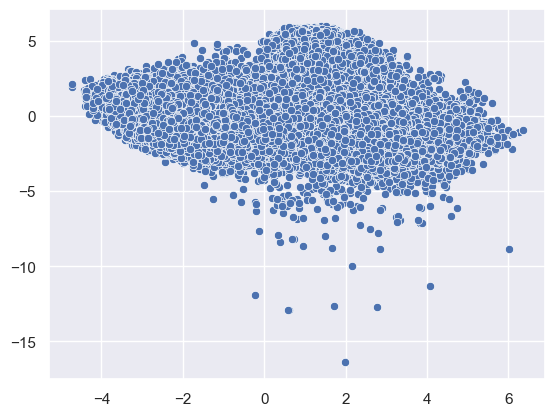

In [14]:
sns.scatterplot(x=V[0]*S[0], y =V[1]*S[1])

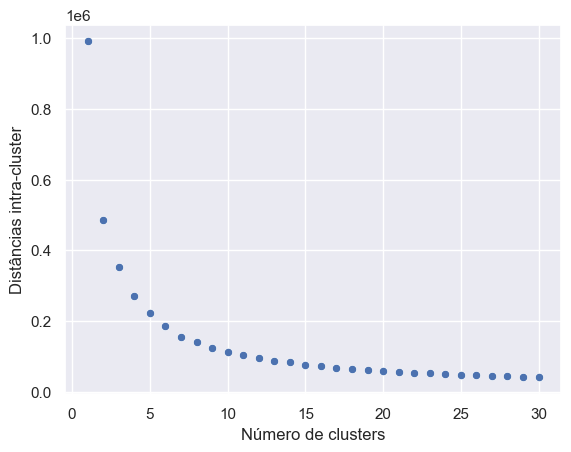

In [88]:
inercia_por_n(matriz_rank_r([U, S, V], 2).T, 30)

In [15]:
kmeans = KMeans(n_clusters=9, n_init="auto", random_state=0)
kmeans.fit(X=list(zip(V[0]*S[0], V[1]*S[1])))
kmeans.labels_

array([2, 6, 2, ..., 1, 4, 4])

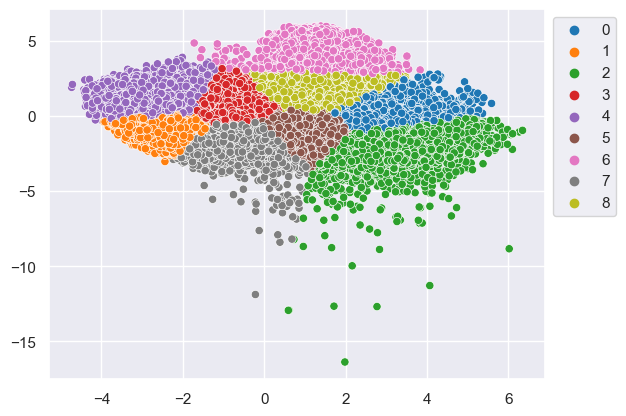

In [16]:
ax = sns.scatterplot(x = V[0] * S[0] , y = V[1] * S[1], hue = kmeans.labels_, palette='tab10')
sns.move_legend(ax,'upper left', bbox_to_anchor=(1,1))

In [2]:
import plotly.express as px

In [29]:
df.loc["componente1"] = V[0]*S[0]
df.loc["componente2"] = V[1]*S[1]
df

name,"Piano Concerto No. 3 in D Minor, Op. 30: III. Finale. Alla breve",Clancy Lowered the Boom,Gati Bali,Danny Boy,When Irish Eyes Are Smiling,Gati Mardika,The Wearing of the Green,"Morceaux de fantaisie, Op. 3: No. 2, Prélude in C-Sharp Minor. Lento",La Mañanita - Remasterizado,Il Etait Syndiqué,...,Soda (feat. Take A Daytrip),Sunblind,We Contain Multitudes (from home),NASTY GIRL / ON CAMERA,Med slutna ögon,China,Halloweenie III: Seven Days,AYA,Darkness,Billetes Azules (with J Balvin)
valence,-1.782825,1.650688,-1.858821,-1.381564,-1.04718,-1.26377,-0.465809,-1.730767,0.731133,0.921124,...,1.437899,-0.23782,-1.366365,-0.02503,-1.690109,0.301754,0.780531,0.411949,-1.26757,0.430948
year,-2.15247,-2.15247,-2.15247,-2.15247,-2.15247,-2.15247,-2.15247,-2.15247,-2.15247,-2.15247,...,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302,1.667302
acousticness,1.276187,0.611347,1.22034,1.236296,1.209703,0.204465,1.313418,1.30544,1.313418,1.276187,...,-1.309986,-0.510902,1.308099,-0.792794,1.254912,-1.110321,-0.787475,-1.066708,-1.308762,-0.984268
danceability,-1.467013,1.598779,-1.18882,-1.489722,-0.677855,0.906137,-0.110116,-0.8425,-0.29747,0.832331,...,2.155163,0.139689,-1.455658,0.344075,-2.057461,1.411425,1.019685,0.548461,0.758525,1.808842
duration_ms,4.763146,-0.399747,2.133824,-0.166101,-0.509485,1.301381,-0.566464,-0.096539,-0.550503,-0.272668,...,-0.020737,0.17971,-0.320718,-0.002762,-0.772675,0.561107,-0.63666,-0.155952,0.842058,-0.328591
energy,-1.013988,-0.52827,-1.182122,-0.647832,-1.081242,-0.509589,-1.043879,-1.473552,-1.316628,-0.842119,...,0.323605,0.760751,-1.677928,-0.038816,-1.773988,1.216579,1.011083,1.403394,0.525365,0.891521
explicit,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,-0.303955,...,3.289955,-0.303955,-0.303955,3.289955,-0.303955,-0.303955,-0.303955,-0.303955,3.289955,3.289955
instrumentalness,2.268102,-0.532771,2.379754,-0.532682,-0.532765,0.003159,-0.532771,1.148391,-0.051072,-0.532771,...,-0.532771,-0.460994,2.526497,-0.532721,2.418035,-0.531849,-0.532771,-0.532743,-0.532746,-0.517745
key,1.365588,0.512123,-0.62583,-0.056853,-0.62583,-0.910318,-1.479295,-1.194806,-0.056853,0.796611,...,0.512123,0.512123,0.227635,-1.479295,0.512123,0.512123,0.512123,-0.341342,-0.910318,0.512123
liveness,2.626719,-0.262229,-0.599749,1.002043,0.132499,-0.433849,-0.51966,0.899071,-0.582587,1.705688,...,-0.734757,-0.462453,-0.60833,-0.559704,-0.531101,-0.707298,-0.599749,0.298399,2.500864,-0.136374


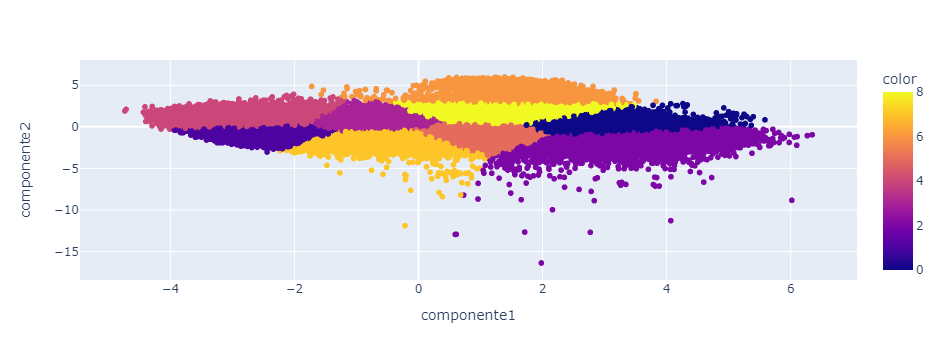

In [36]:
px.scatter(df.transpose().reset_index(), x="componente1", y="componente2", color=kmeans.labels_, hover_data="name")